# Constrained-Mechanical-Systems-Forward-Dynamic-Simulation-of-Chain-links
Multibody dynamics modeling and numerical methods

## 1 Explicit calculation of the Lagrange multiplier

### Close-chain Four-link
#### Give 5Nm at top joint.

In [1]:
%matplotlib inline
import time
import numpy as np
import sympy as sp
from scipy.integrate import solve_ivp
from IPython.display import display, Markdown
from Models.models import *
from utils.SolutionDemo import *
sp.init_printing()

In [2]:
def print_constrains(Demo):
    display(Markdown("### System constrains:"))
    constrains = Demo.constrains()
    for item in constrains:
        display(sp.Eq(item, 0))
        
def print_govs(Model, f):
    '''
    print governing equations without damping for now
    '''
    display(Markdown("### System governing equations"))
    L = Model.lagrangian()
    left = (L.jacobian(Model.q_dot)).diff(Model.t)
    right = L.jacobian(Model.q)
    
    for i, item in enumerate(left):
        display(sp.Eq(item, right[i] + f[i]))

In [16]:
m=[1, 1, 1]
l=[1, 4, 2.5, 3]
Fourbar_Model = ExplictModel(m=m, l=l, close_chain=True)    
y = np.append([0, 0.5, np.pi/2, 1.8765, 1.692, 0.3533, 3.3765, 1.192, -1.8767], np.zeros(3*len(m)))
g = np.tile([9.81, 0, 0], len(m))
f = [0, 0, 5, 0, 0, 0, 0, 0, 0]

### System constrains:

### System governing equations

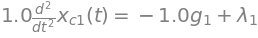

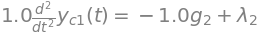

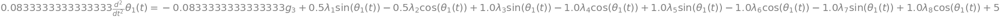

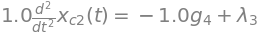

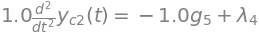

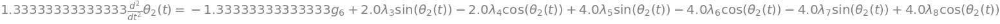

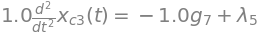

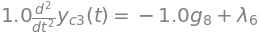

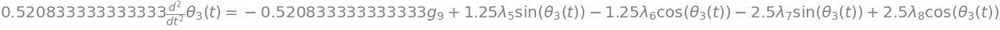

In [8]:
print_constrains(Fourbar_Model)
print_govs(Fourbar_Model, f)

In [9]:
ode = 'RK45'
sol = solve_ivp(Fourbar_Model.sim, [0, 10], y, method=ode, args=(f, g, None))
Fourbar = SolutionDemo(sol, m, l, rot=-np.pi/2)
print(Fourbar.links.shape)

(3, 84, 2, 2)


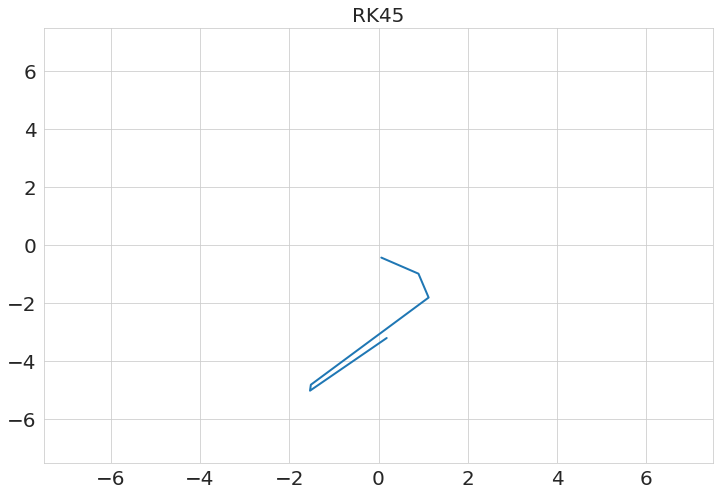

In [10]:
Fourbar.play_IPython(ode)

RK45 doesn't work!

In [17]:
ode = 'RK23'
sol = solve_ivp(Fourbar_Model.sim, [0, 10], y, method=ode, args=(f, g, None))
Fourbar = SolutionDemo(sol, m, l, rot=-np.pi/2)
print(Fourbar.links.shape)

(3, 426, 2, 2)


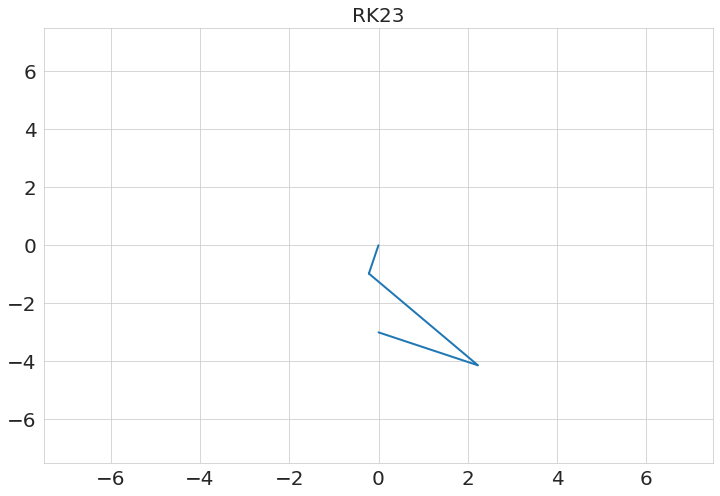

In [18]:
Fourbar.play_IPython(ode)

In [19]:
ode = 'DOP853'
sol = solve_ivp(Fourbar_Model.sim, [0, 10], y, method=ode, args=(f, g, None))
Fourbar = SolutionDemo(sol, m, l, rot=-np.pi/2)
print(Fourbar.links.shape)

(3, 92, 2, 2)


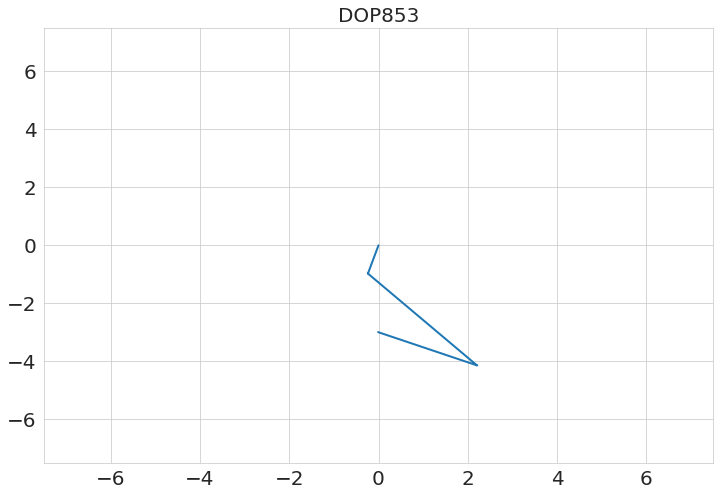

In [20]:
Fourbar.play_IPython(ode)

### Double Pendulum

In [3]:
m=[1, 1]
l=[1, 1]
Twobar_Model = ExplictModel(m=m, l=l,close_chain=False)
y = np.append([0.5, 0, 0, 1.5, 0, 0], np.zeros(3*len(m)))
g = np.tile([0, -9.81, 0], len(m))
f = [0, 0, 0, 0, 0, 0]

### System constrains:

### System governing equations

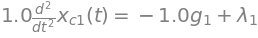

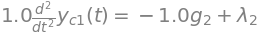

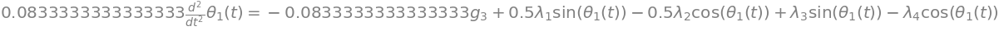

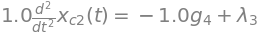

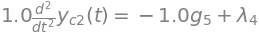

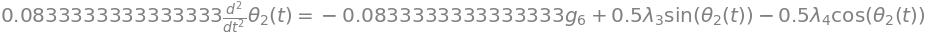

In [4]:
print_constrains(Twobar_Model)
print_govs(Twobar_Model, f)

In [5]:
ode = 'DOP853'
sol = solve_ivp(Twobar_Model.sim, [0, 10], y, method=ode, args=(f, g))
Twobar = SolutionDemo(sol, m, l, rot=None)
print(Twobar.links.shape)

(2, 85, 2, 2)


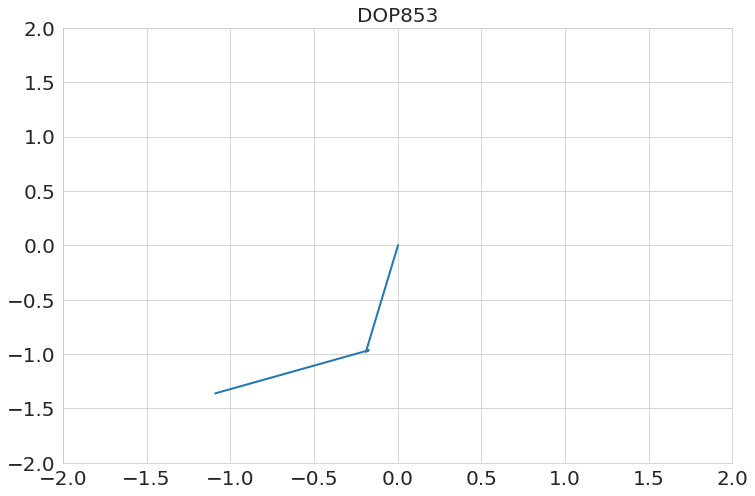

In [6]:
Twobar.play_IPython(ode)

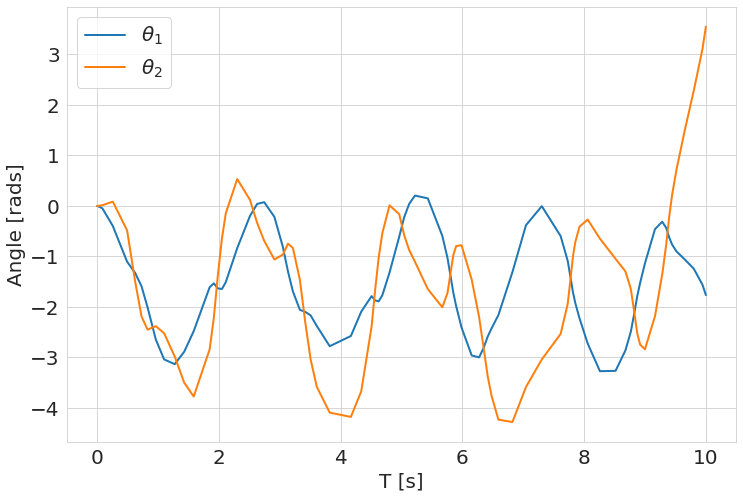

In [7]:
Twobar.plot_angles()

### Triple Pendulum

In [8]:
m=[1, 1, 1]
l=[1, 1, 1]
Threebar_Model = ExplictModel(m=m, l=l,close_chain=False)
y = np.append([0.5, 0, 0, 1.5, 0, 0, 2.5, 0, 0], np.zeros(3*len(m)))
g = np.tile([0, -9.81, 0], len(m))
f = [0, 0, 0, 0, 0, 0, 0, 0, 0]

### System constrains:

### System governing equations

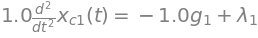

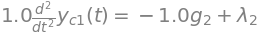

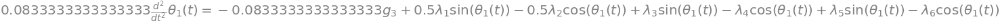

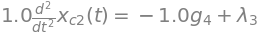

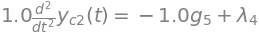

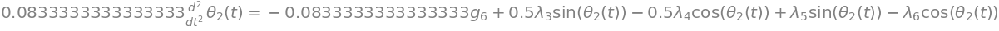

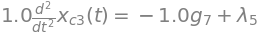

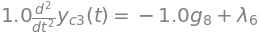

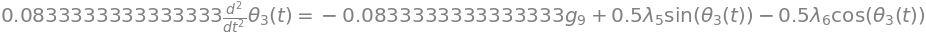

In [9]:
print_constrains(Threebar_Model)
print_govs(Threebar_Model, f)

In [11]:
ode = 'DOP853'
sol = solve_ivp(Threebar_Model.sim, [0, 10], y, method=ode, args=(f, g))
Threebar = SolutionDemo(sol, m, l, rot=None)
print(Twobar.links.shape)

(2, 85, 2, 2)


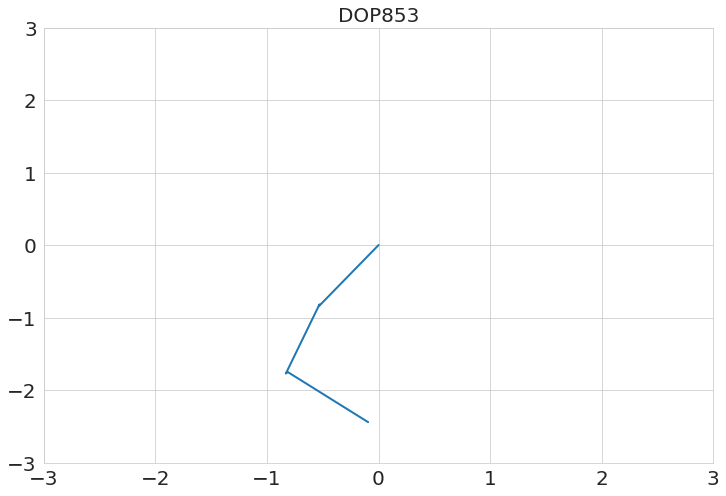

In [12]:
Threebar.play_IPython(ode)

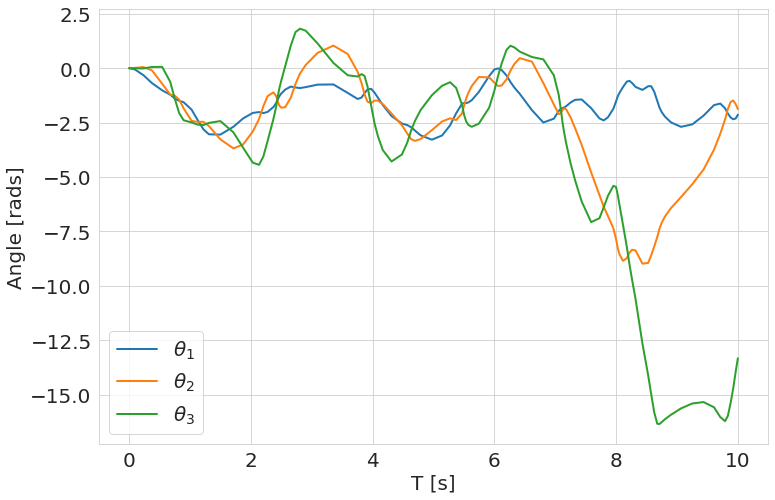

In [14]:
Threebar.plot_angles()

### Quadruple Pendulum

In [22]:
m=[1, 1, 1, 1]
l=[1, 1, 1, 1]
Four_Model = ExplictModel(m=m, l=l,close_chain=False)
y = np.append([0.5, 0, 0, 1.5, 0, 0, 2.5, 0, 0, 3.5, 0, 0], np.zeros(3*len(m)))
g = np.tile([0, -9.81, 0], len(m))
f = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

### System constrains:

### System governing equations

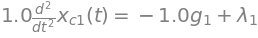

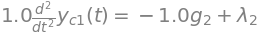

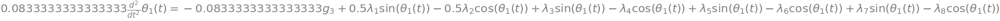

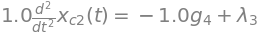

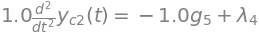

...

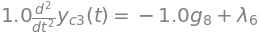

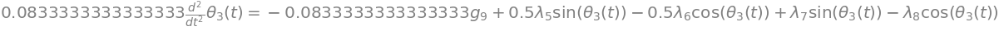

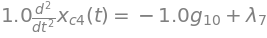

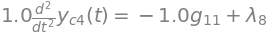

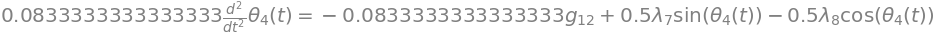

In [23]:
print_constrains(Four_Model)
print_govs(Four_Model, f)

In [24]:
ode = 'DOP853'
sol = solve_ivp(Four_Model.sim, [0, 10], y, method=ode, args=(f, g))
FourPend = SolutionDemo(sol, m, l, rot=None)
print(FourPend.links.shape)

(4, 135, 2, 2)


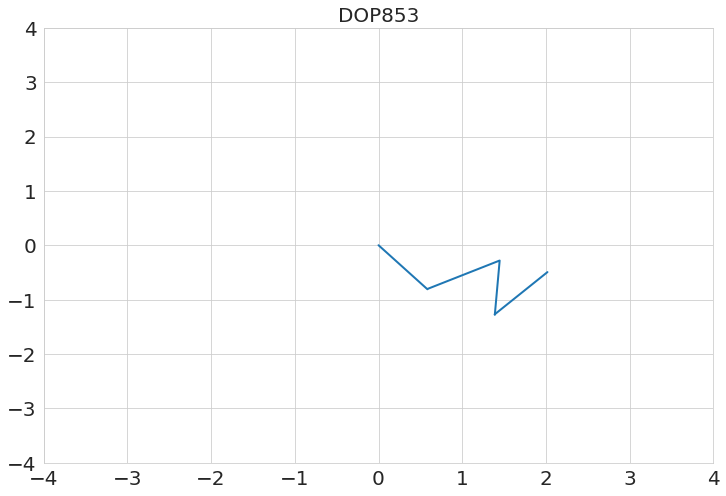

In [25]:
FourPend.play_IPython(ode)

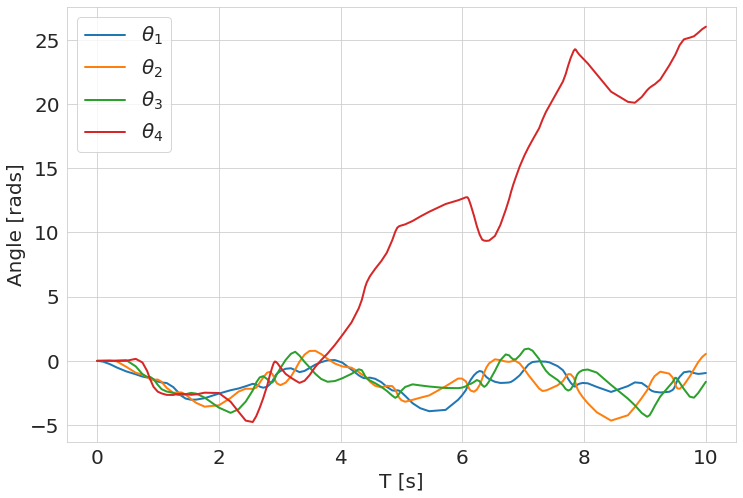

In [26]:
FourPend.plot_angles()